In [385]:
import cv2
import numpy as np
import numpy.fft as fft

from PIL import Image, ImageDraw, ImageFont

import matplotlib.pyplot as plt
from matplotlib import  rcParams

# inline显示图像
%matplotlib inline

rcParams['font.family'] = 'monospace'
rcParams['font.monospace'] = ['Ubuntu Mono', 'JetBrains Mono', 'Consolas', 'monospace']

In [386]:
WATER_MARK_ALPHA = 0.04
TAMPER_LOCATE_CROP = 0.05
BLUR_SIZE = 128
block_size = (32,32,3)
# 文字转图片，字体大小填充图片高度
def text_to_img(text, img_height):
    font = ImageFont.truetype('consola', img_height)
    img_width = int(font.getlength(text))
    img = Image.new('RGB', (img_width, img_height), (0, 0, 0))
    draw = ImageDraw.Draw(img)
    draw.text((0, 0), text, font=font, fill=(255, 255, 255))
    return np.array(img)

# 载入适合频域的水印
# 如果是 type 为 text 则生成内容为 name 的图片作为水印
# 如果是 type 为 image 则载入目录下名称为 name 的图片作为水印, 将图片等比缩放至高度为 height

def load_water_mark(img:np.ndarray,type: str, name: str, height: int = None):
    if type == 'text':
        wm = text_to_img(name, height)
    elif type == 'image':
        wm = cv2.imread(name)
        if height is not None:
            wm = cv2.resize(img, (int(img.shape[1] * height / img.shape[0]), height))
    else:
        raise Exception('type must be text or image')
    return wm

# 制作水印
# 创建 target 大小的图片
def make_water_mark(target: np.ndarray, water_mark: np.ndarray, offset: tuple = (0, 0)):
    wm = np.zeros(target.shape, dtype=np.uint8)
    # 制作
    wm[-water_mark.shape[0]-offset[0]:-offset[0], -water_mark.shape[1]-offset[1]:-offset[1]] = water_mark
    wm = wm[::-1, ::-1]
    wm[-water_mark.shape[0]-offset[0]:-offset[0], -water_mark.shape[1]-offset[1]:-offset[1]] = water_mark
    wm = wm[::-1, ::-1]
    return np.uint8(wm)


# 图像显示辅助函数
# 并排显示 n*m 张图像，n行m列
# 在每张图左侧和顶侧显示像素坐标，在每张图顶侧显示标题
def show_images(images: list, titles: list, n: int, m: int):
    plt.figure(dpi=800)
    plt.subplots_adjust(wspace=0.5, hspace=0.5)
    for i in range(n):
        for j in range(m):
            plt.subplot(n, m, i * n + j + 1)
            plt.imshow(images[i * n + j], cmap='gray')
            plt.title(titles[i * n + j])
    plt.show()

# 频谱中心化、对数化、归一化、*255
def center_log_spectrum(spectrum: np.ndarray):
    spectrum = np.log(np.abs(spectrum) + 1)
    spectrum = (spectrum - np.min(spectrum))*255 // (np.max(spectrum) - np.min(spectrum))
    return np.uint8(spectrum)


def rgb_fft2(rgbImage):
    # 对rgb图像分通道做fft2，并将高频分量移至中心
    if(rgbImage.__class__==np.ndarray):
        return fft.fftshift(fft.fft2(rgbImage,axes=(0,1)),axes=(0,1))
    elif(rgbImage.__class__==list):
        return [fft.fftshift(fft.fft2(i,axes=(0,1)),axes=(0,1)) for i in rgbImage]
    else:
        return None
    

def rgb_ifft2(rgbImage_fft_shift):
    # 上一函数的逆过程
    if(rgbImage_fft_shift.__class__==np.ndarray):
        return fft.ifft2(fft.ifftshift(rgbImage_fft_shift,axes=(0,1)),axes=(0,1))
    elif(rgbImage_fft_shift.__class__==list):
        return [fft.ifft2(fft.ifftshift(i,axes=(0,1)),axes=(0,1)) for i in rgbImage_fft_shift]
    else:
        return None


def rgb_dct2(rgbImage:np.ndarray):
    '''
    对rgbImage作dct变换，返回数据类型为float32的频域图像
    '''
    return np.transpose([cv2.dct(np.float32(rgbImage[:,:,i])) for i in range(3)],axes=(1,2,0))
def rgb_idct2(rgbImage_dct:np.ndarray):
    '''
    对rgbImage_idct作逆dct变换，返回数据类型为uint8的空域图像
    '''
    Img_idct2 = np.transpose([cv2.idct(rgbImage_dct[:,:,i]) for i in range(3)],axes=(1,2,0))
    # print(np.max(Img_idct2),np.min(Img_idct2))
    Img_idct2_qua = Img_idct2.copy()
    for i in range(Img_idct2_qua.shape[0]):
        for j in range(Img_idct2_qua.shape[1]):
            for k in range(Img_idct2_qua.shape[2]):
                if(Img_idct2_qua[i,j,k]>255):
                    Img_idct2_qua[i,j,k]=255
                elif(Img_idct2_qua[i,j,k]<0):
                    Img_idct2_qua[i,j,k]=0
                else:
                    Img_idct2_qua[i,j,k]=round(Img_idct2_qua[i,j,k])
    Img_idct2_qua = np.uint8(Img_idct2_qua)
    return Img_idct2_qua



def get_feature(Image:np.ndarray,block_size:tuple):
    feature = np.zeros(shape=(int(Image.shape[0]/block_size[0]),int(Image.shape[1]/block_size[1]),3))
    for i in range(feature.shape[0]):
        for j in range(feature.shape[1]):
            feature[i,j,:] = np.ptp(  Image[block_size[0]*i : block_size[0]*(i+1),block_size[1]*j : block_size[1]*(j+1),:],axis=(0,1))
    feature = np.uint8((feature - np.min(feature))*255 // (np.max(feature) - np.min(feature)))
    return feature

def differ(img1_fea:np.ndarray,img2_fea:np.ndarray,return_pos=True):
    sum = 0
    position = []
    for i in range(img1_fea.shape[0]):
        for j in range(img1_fea.shape[1]):
            if(np.max(np.abs(img1_fea[i,j,:]-img2_fea[i,j,:])) > 100):
                sum = sum+1
                if(return_pos == True):
                    position.append((i,j))
    if(return_pos == True):
        return position,sum/(img1_fea.shape[0]*img1_fea.shape[1])
    else:
        return sum/(img1_fea.shape[0]*img1_fea.shape[1])

    
def extract(Image:np.ndarray,wm_size:tuple):
    wm_ext = np.zeros(shape=wm_size)
    Image_dct = rgb_dct2(Image)
    for i in range(wm_size[0]):
        for j in range(wm_size[1]):
            di = 64//wm_size[0]
            dj = 64//wm_size[1]
            wm_ext[i,j,:] = Image_dct[447+i*di,447+j*dj,:] * 4
    return wm_ext

def mark_diff(Image,position,block_shape):
    Image_marked = Image.copy()
    for pos in position:
        start_point = (pos[0]*block_shape[0],pos[1]*block_shape[1])
        end_point = (pos[0]*block_shape[0]+block_shape[0],pos[1]*block_shape[1]+block_shape[1])
        cv2.rectangle(Image_marked,start_point , end_point, (255, 0, 0), thickness= 3, lineType=cv2.LINE_8) 
    return Image_marked

Read RGB Image and Generate watermark

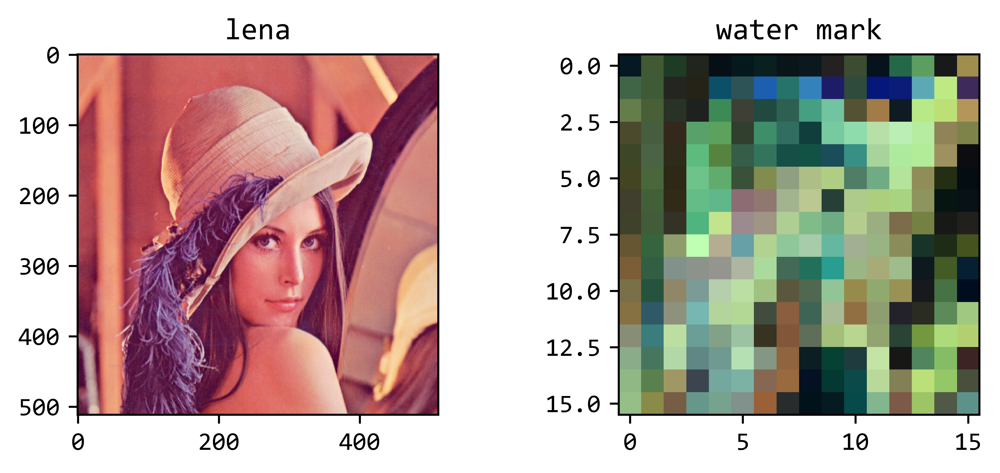

In [387]:
# 读取 lena rgb 位图 LenaRGB.bmp，通道顺序 (b,g,r)
img_bgr = cv2.imread('LenaRGB.bmp', cv2.IMREAD_COLOR)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# 载入水印
wm_ori = wm_ori = get_feature(img_rgb,block_size)

show_images([img_rgb, wm_ori], ['lena', 'water mark'], 1, 2)

Load watermark

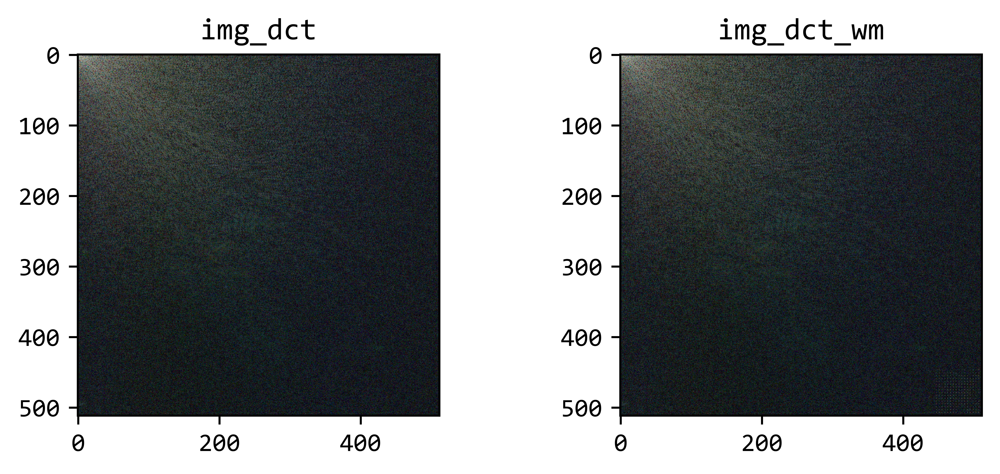

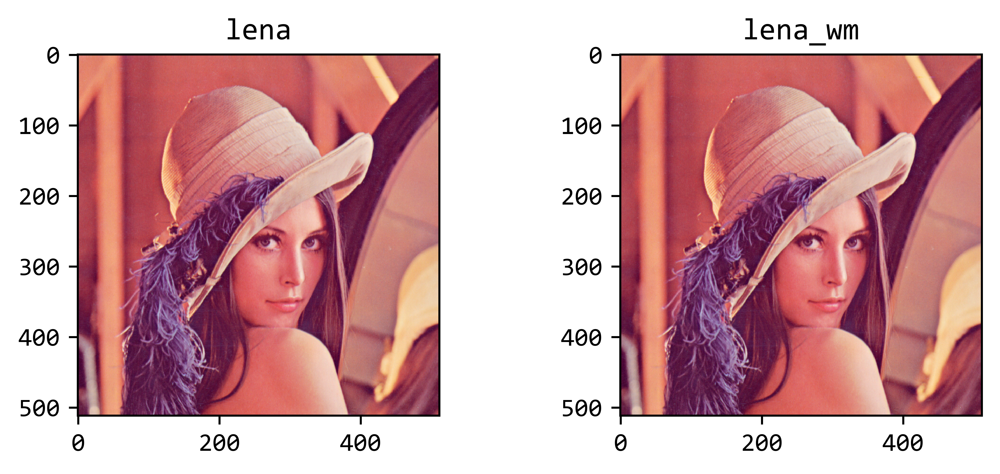

Extracted feature and origin feature differs : 0.000000


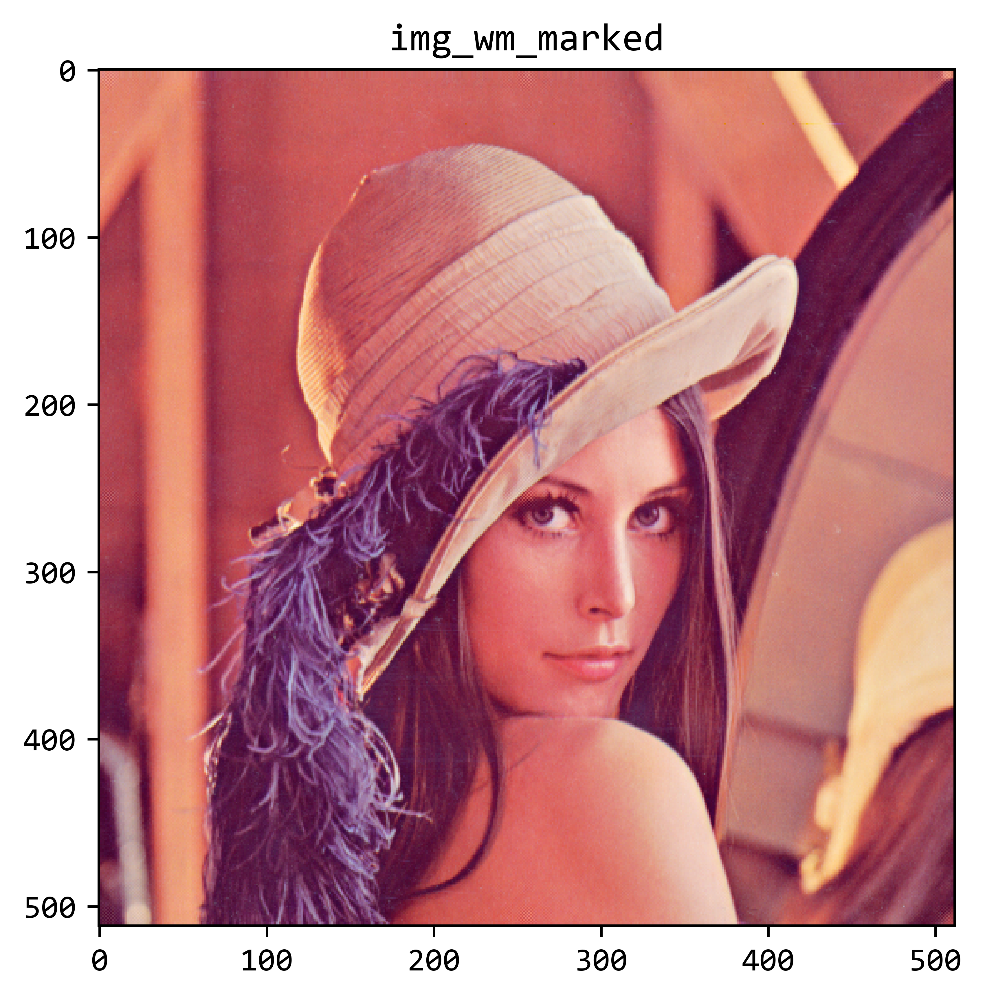

In [388]:


img_dct = rgb_dct2(img_rgb)

img_dct_wm = img_dct.copy()

# add watermark
for i in range(wm_ori.shape[0]):
    for j in range(wm_ori.shape[1]):
        di = 64//wm_ori.shape[0]
        dj = 64//wm_ori.shape[1]
        img_dct_wm[447+i*di,447+j*dj,:] = wm_ori[i,j,:]//4
show_images([center_log_spectrum(img_dct) ,center_log_spectrum(img_dct_wm)],['img_dct','img_dct_wm'],1,2)

img_wm = rgb_idct2(img_dct_wm)

# compare img_wm_fea and fea_ext
fea_ext = extract(img_wm,wm_ori.shape)
show_images([img_rgb, img_wm], ['lena', 'lena_wm'], 1, 2)
img_wm_fea = get_feature(img_wm,block_size)
pos,diff = differ(img_wm_fea,fea_ext)
print("Extracted feature and origin feature differs : %f"%(diff))

img_wm_marked = mark_diff(img_wm,pos,block_size)
show_images([img_wm_marked],['img_wm_marked'],1,1)

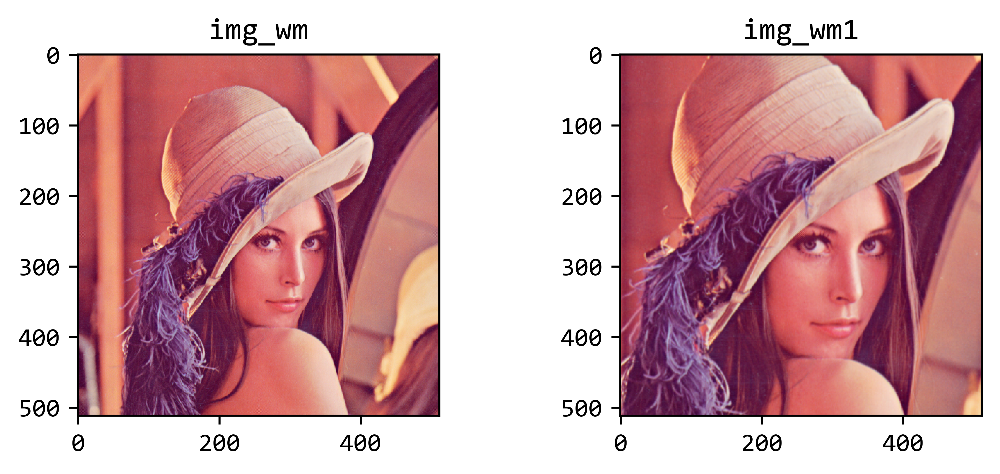

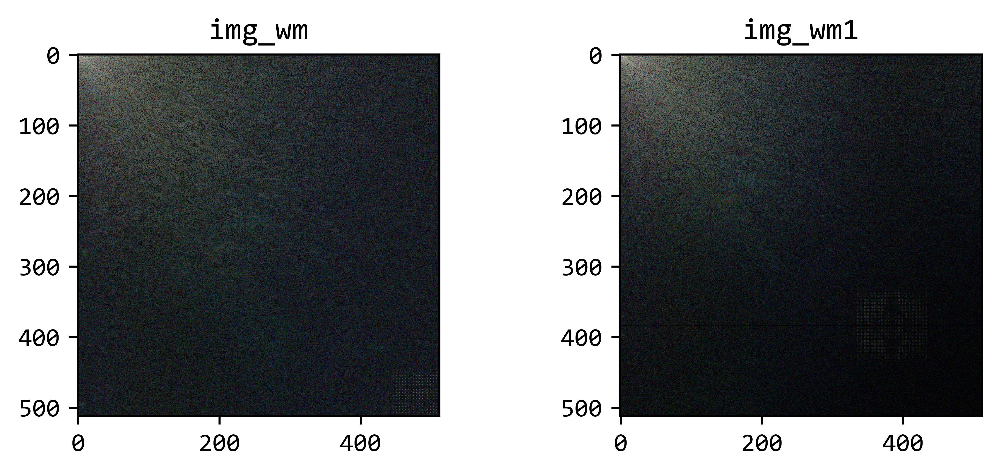

Extracted feature and origin feature differs : 0.601562


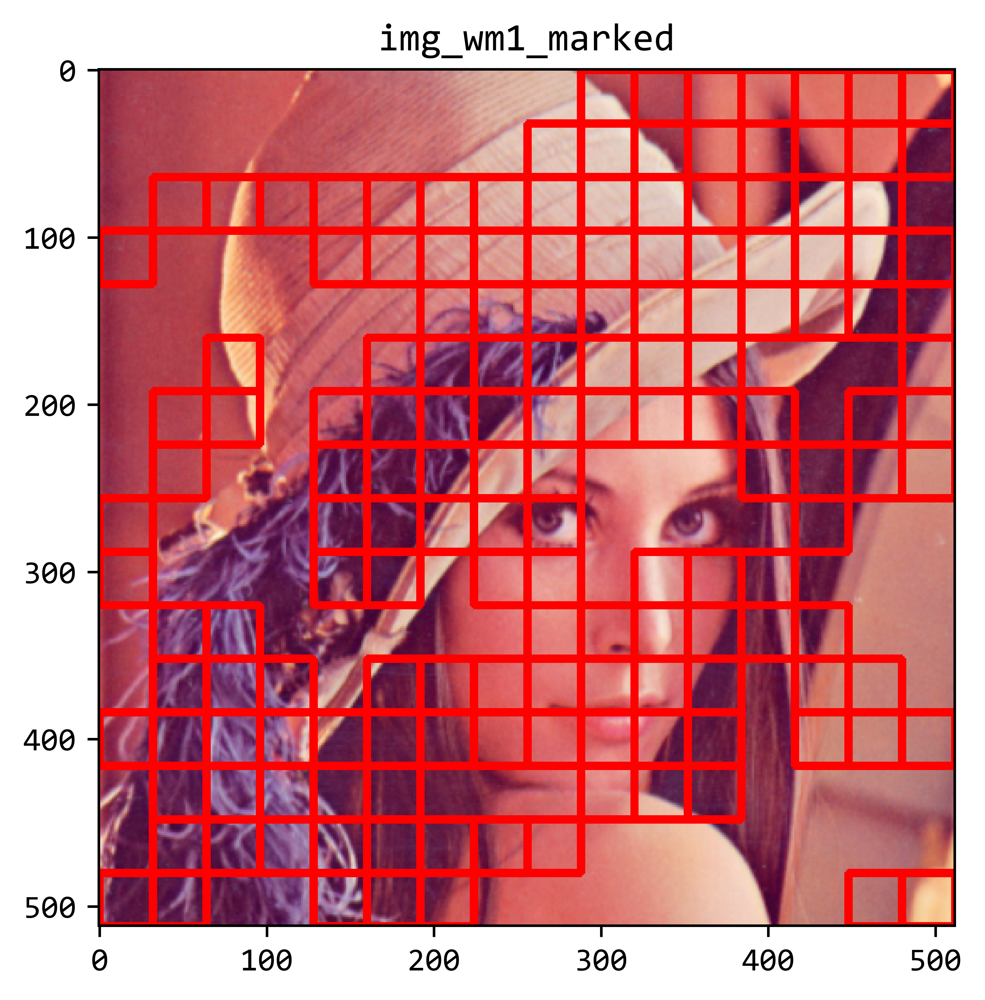

In [389]:
# cut and resize
img_wm1 = img_wm.copy()
img_wm1 = img_wm1[64:-64, 64:-64]
img_wm1 = cv2.resize(img_wm1,(512,512))

wm1_fea = get_feature(img_wm1,block_size)
fea_ext1 = extract(img_wm1,(16,16,3))
show_images([img_wm,img_wm1],['img_wm','img_wm1'],1,2)
show_images([center_log_spectrum(rgb_dct2(img_wm)),center_log_spectrum(rgb_dct2(img_wm1))],['img_wm','img_wm1'],1,2)
pos,diff = differ(fea_ext1,wm1_fea)
print("Extracted feature and origin feature differs : %f"%(diff))
img_wm1_marked = mark_diff(img_wm1,pos,block_size)
show_images([img_wm1_marked],['img_wm1_marked'],1,1)

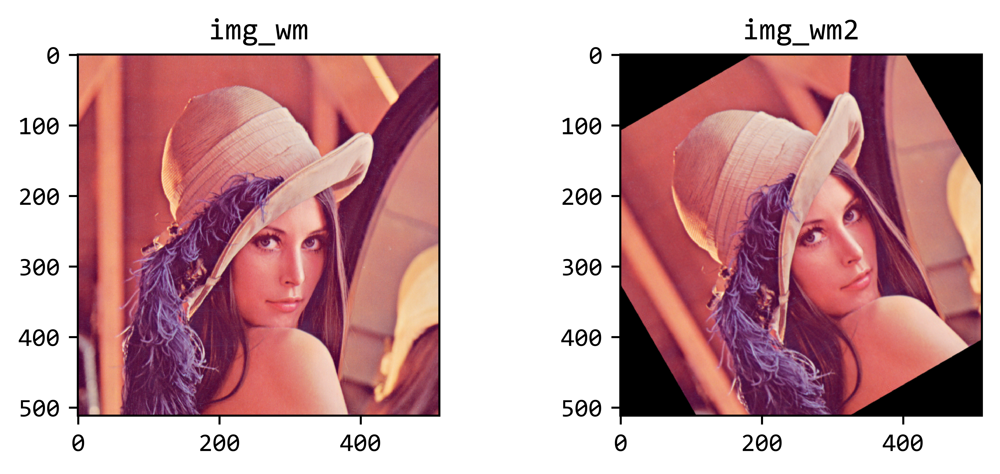

Extracted feature and origin feature differs : 0.679688


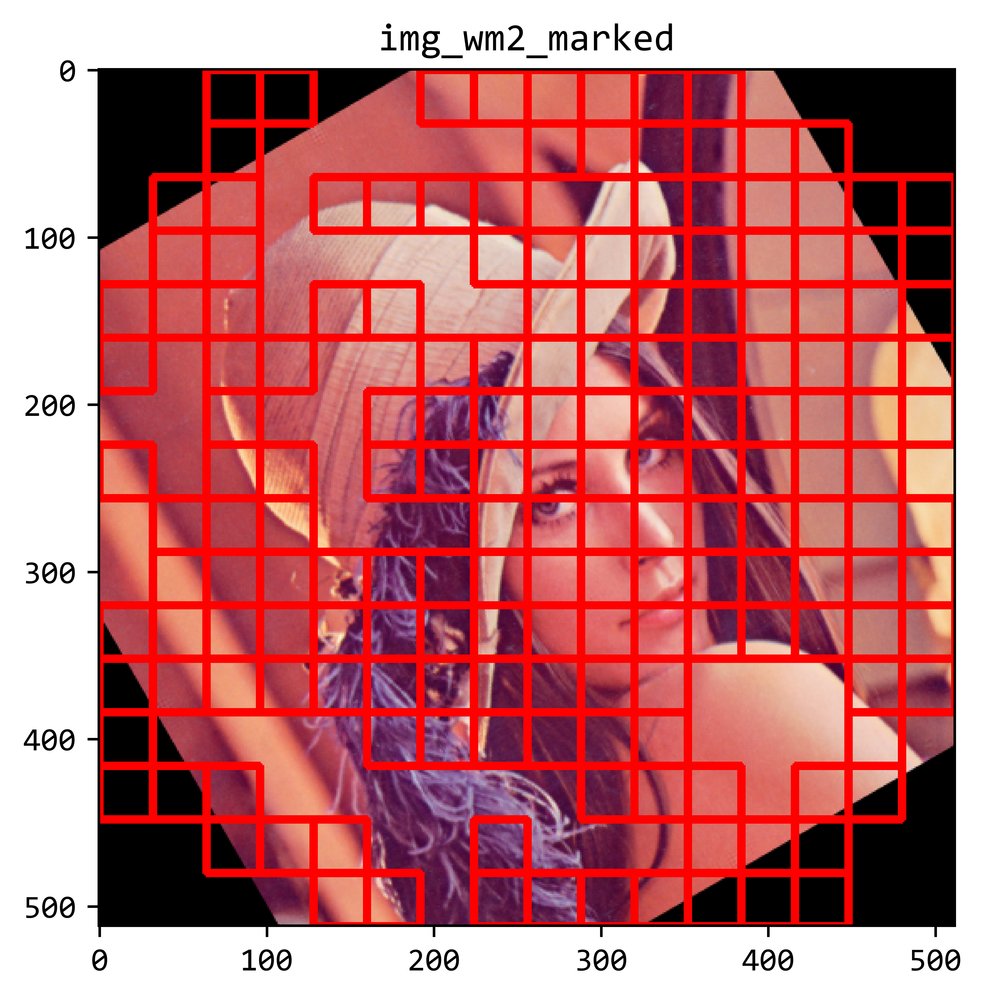

In [390]:
# rotate
img_wm2 = img_wm.copy()
img_wm2 = cv2.warpAffine(img_wm2, cv2.getRotationMatrix2D((img_wm2.shape[1] // 2, img_wm2.shape[0] // 2), 30, 1), (img_wm2.shape[1], img_wm2.shape[0]))
fea_ext2 = extract(img_wm2,(16,16,3))
show_images([img_wm,img_wm2],['img_wm','img_wm2'],1,2)
pos,diff = differ(fea_ext2,get_feature(img_wm2,block_size))
print("Extracted feature and origin feature differs : %f"%(diff))

img_wm2_marked = mark_diff(img_wm2,pos,block_size)
show_images([img_wm2_marked],['img_wm2_marked'],1,1)

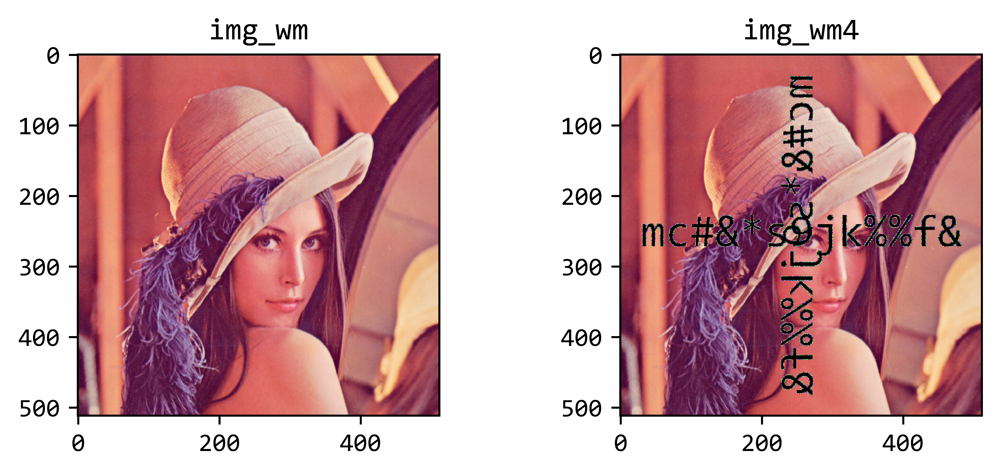

Extracted feature and origin feature differs : 0.375000


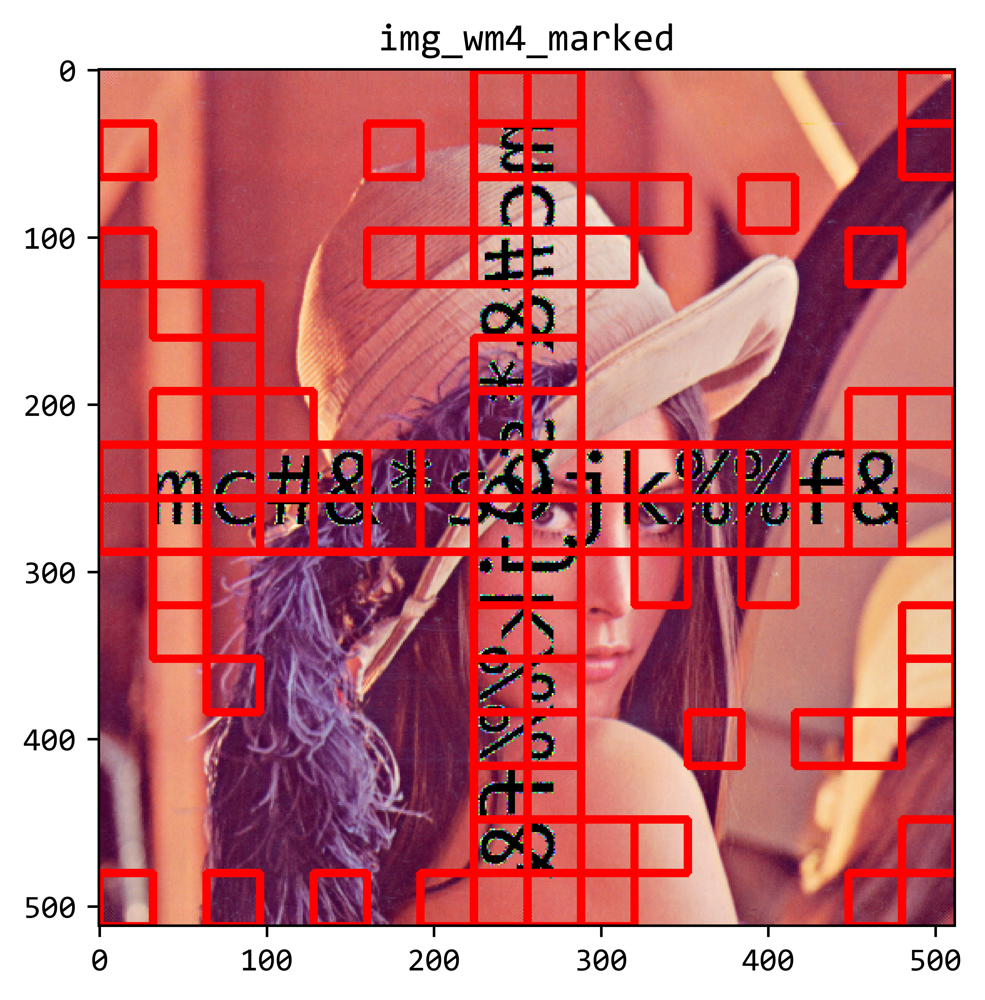

In [391]:
# cover
img_wm4 = img_wm.copy()
new_mark = load_water_mark(img_wm4,'text', 'mc#&*s9jk%%f&', 64)
x1 = img_wm.shape[0] // 2 - new_mark.shape[0] // 2
x2 = x1 + new_mark.shape[0]
y1 = img_wm.shape[1] // 2 - new_mark.shape[1] // 2
y2 = y1 + new_mark.shape[1]
img_wm4[x1:x2, y1:y2] = np.uint64(img_wm4[x1:x2, y1:y2]) * (1 + np.uint64(new_mark))
img_wm4[y1:y2, x1:x2] = np.uint64(img_wm4[y1:y2, x1:x2]) * (1 + np.transpose(np.uint64(new_mark),(1,0,2)))
img_wm4[img_wm4 > 255] = 255
img_wm4[img_wm4 < 0] = 0
img_wm4 = np.uint8(img_wm4)

fea_ext3 = extract(img_wm4,(16,16,3))
show_images([img_wm,img_wm4],['img_wm','img_wm4'],1,2)
pos,diff = differ(get_feature(img_wm4,block_size),fea_ext3)
print("Extracted feature and origin feature differs : %f"%(diff))
img_wm4_marked = mark_diff(img_wm4,pos,block_size)
show_images([img_wm4_marked],['img_wm4_marked'],1,1)

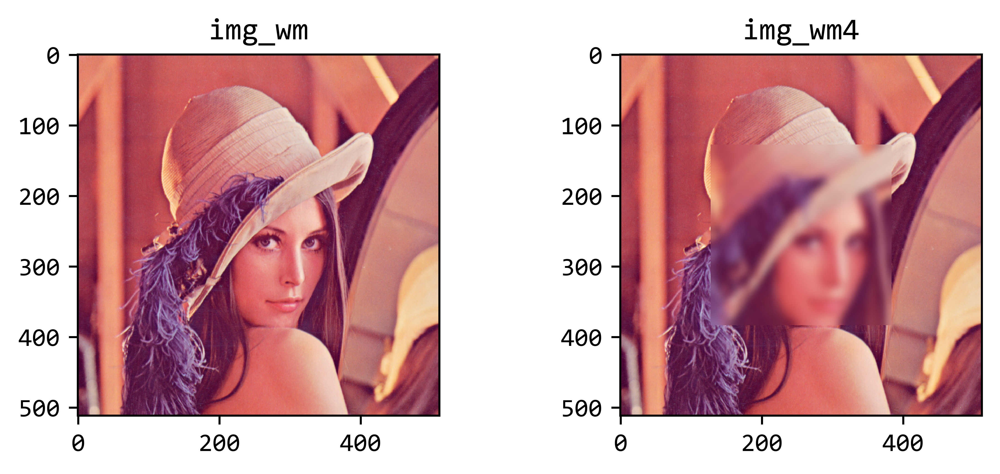

Extracted feature and origin feature differs : 0.000000


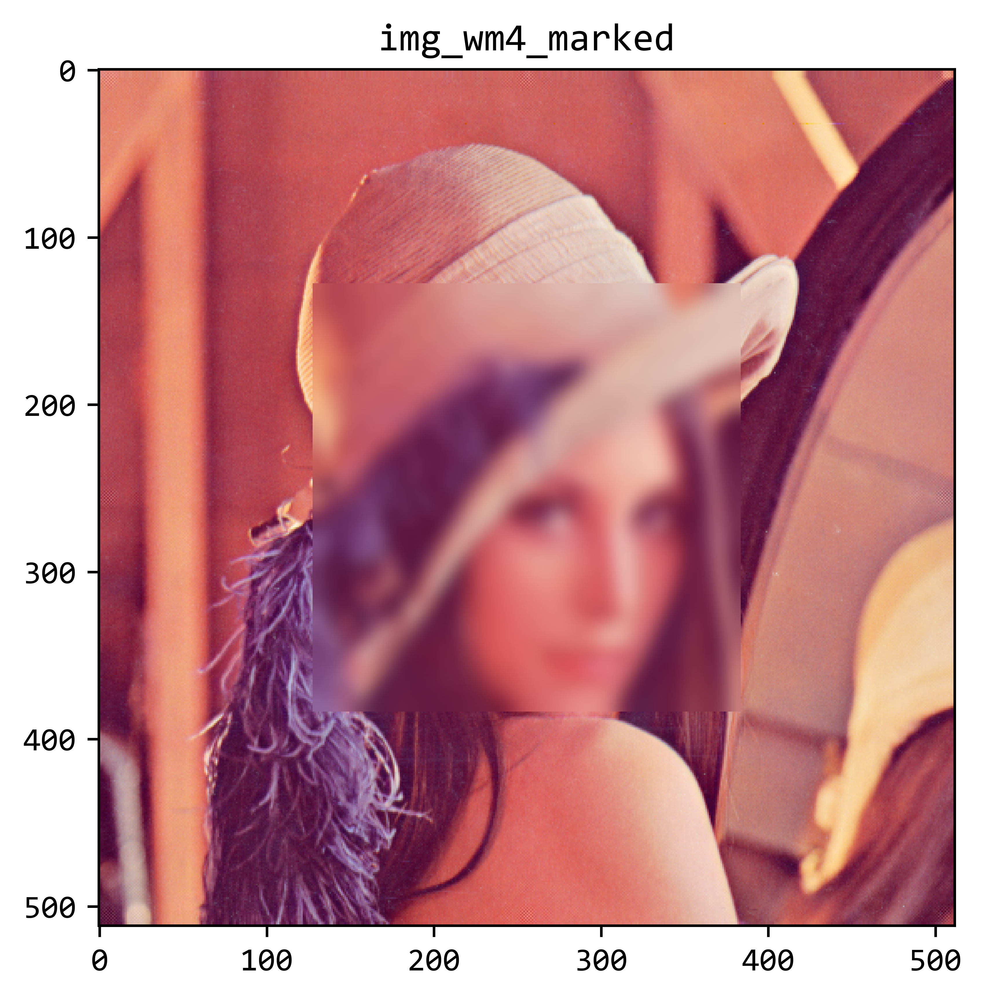

In [392]:
# Gaussian Blur (Fail to detect)

img_wm4 = img_wm.copy()

img_wm4[img_wm4.shape[0]//2-BLUR_SIZE:img_wm4.shape[0]//2+BLUR_SIZE, img_wm4.shape[1]//2-BLUR_SIZE:img_wm4.shape[1]//2+BLUR_SIZE] = \
    cv2.GaussianBlur(img_wm4[img_wm4.shape[0]//2-BLUR_SIZE:img_wm4.shape[0]//2+BLUR_SIZE, img_wm4.shape[1]//2-BLUR_SIZE:img_wm4.shape[1]//2+BLUR_SIZE], (33, 33), 0)

fea_ext4 = extract(img_wm4,(16,16,3))
wm_fea4 = get_feature(img_wm4,block_size)
show_images([img_wm,img_wm4],['img_wm','img_wm4'],1,2)
pos,diff = differ(wm_fea4,fea_ext4)
print("Extracted feature and origin feature differs : %f"%(diff))
img_wm4_marked = mark_diff(img_wm4,pos,block_size)
show_images([img_wm4_marked],['img_wm4_marked'],1,1)

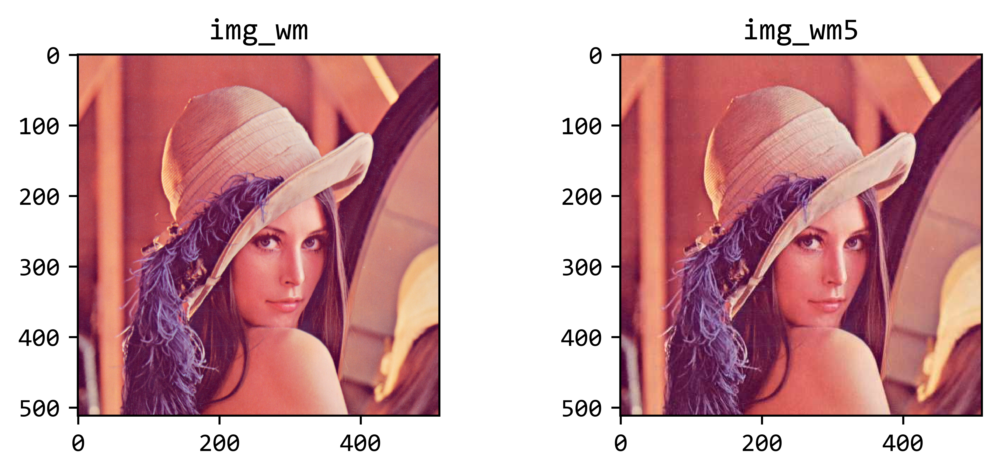

Extracted feature and origin feature differs : 0.335938


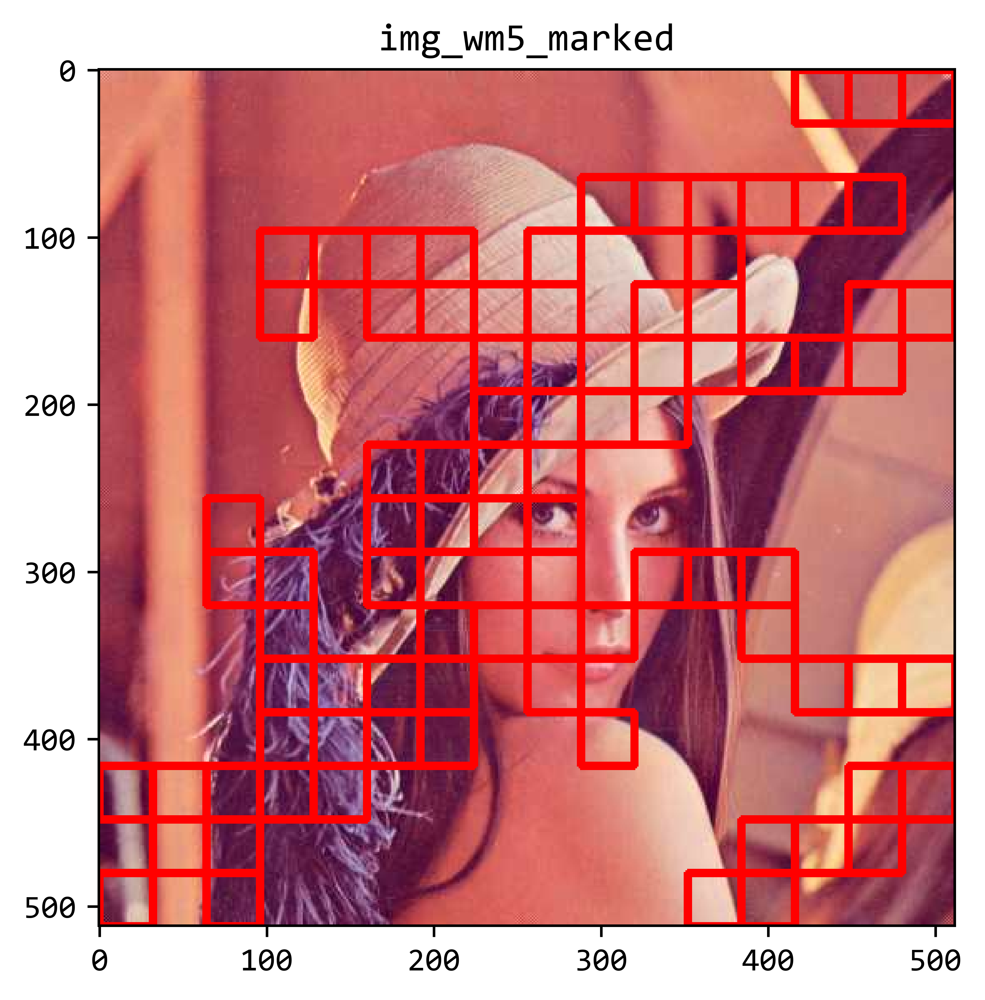

In [393]:
# compression

img_wm5 = img_wm.copy()
# 将 img_wm 进行 jpeg 压缩
cv2.imwrite('tmp.jpg', img_wm5, [int(cv2.IMWRITE_JPEG_QUALITY), 50])
img_wm5 = cv2.imread('tmp.jpg')

fea_ext5 = extract(img_wm5,(16,16,3))
wm_fea5 = get_feature(img_wm5,block_size)
show_images([img_wm,img_wm5],['img_wm','img_wm5'],1,2)
pos,diff = differ(wm_fea5, fea_ext5)
print("Extracted feature and origin feature differs : %f"%(diff))
img_wm5_marked = mark_diff(img_wm5,pos,block_size)
show_images([img_wm5_marked],['img_wm5_marked'],1,1)

